In [77]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import stats
from datetime import datetime
dateparse = lambda x: datetime.strptime(x, '%m/%d/%Y %H:%M')
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits import mplot3d
from sklearn import preprocessing, svm 
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression 

In [78]:
df = pd.read_csv('./inv4_emi_data_t345678.csv',
                encoding="utf-8-sig",
                header=0,
                infer_datetime_format=True,
                parse_dates={'datetime':[5]},
                index_col=['datetime']
                )

In [79]:
df['time'] = df.index
df['year'] = df.index.year
df['month'] = df.index.month
df['day'] = df.index.day
df['hour'] = df.index.hour
df['dayofweek'] = df.index.dayofweek
df['dayname'] = df.index.day_name()
df['hourofweek'] = df.hour+24*df.dayofweek
df['hourofmonth'] = df.hour+24*(df.day-1)
df['Tcell']=df['Ambient temperature(℃)']+df['Irradiance(W/㎡)']/800*(25-20)
df['Pm']=2.172*1.303*220*2*590*df['Irradiance(W/㎡)']/1000*(1+0.0045*(df['Tcell']-25))*20.5/100
df['Hieu suat']=df['Total input power(kW)']*1000/df['Pm']*100
df['date'] = df.index.date
df=df[(df['Inverter status']=='Grid connected')|(df['Inverter status']=='Grid connected : power limited')]
df.head(10)

,Unnamed: 0.1,Unnamed: 0,Site Name,Management Domain,ManageObject_x,Ambient temperature(℃),PV Temperature(℃),Wind speed(m/s),Wind direction(°),Daily irradiation(MJ/㎡),...,day,hour,dayofweek,dayname,hourofweek,hourofmonth,Tcell,Pm,Hieu suat,date
datetime,,,,,,,,,,,,,,,,,,,,,
2022-03-03 14:50:00,8,8,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.4,28.4,1.4,NaN,0.569,...,3,14,3,Thursday,86,62,25.329375,22429.365269,79.988889,2022-03-03
2022-03-03 14:55:00,9,9,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.2,27.4,2.2,NaN,0.608,...,3,14,3,Thursday,86,62,24.945000,17948.639716,79.409918,2022-03-03
2022-03-03 15:00:00,10,10,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.2,27.1,2.1,NaN,0.643,...,3,15,3,Thursday,87,63,24.903125,16936.588731,78.793907,2022-03-03
2022-03-03 15:05:00,11,11,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.3,27.1,1.2,NaN,0.677,...,3,15,3,Thursday,87,63,24.997500,16808.234348,79.591941,2022-03-03
2022-03-03 15:10:00,12,12,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,23.9,26.9,2.5,NaN,0.710,...,3,15,3,Thursday,87,63,24.628125,17517.064848,81.240779,2022-03-03
2022-03-03 15:15:00,13,13,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.2,27.3,1.7,NaN,0.747,...,3,15,3,Thursday,87,63,25.011875,19565.688902,81.668476,2022-03-03
2022-03-03 15:20:00,14,14,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.3,27.6,2.0,NaN,0.790,...,3,15,3,Thursday,87,63,25.266875,23327.830288,81.280598,2022-03-03
2022-03-03 15:25:00,15,15,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.1,27.9,2.0,NaN,0.839,...,3,15,3,Thursday,87,63,25.182500,26107.614506,81.543260,2022-03-03
2022-03-03 15:30:00,16,16,VNM - Đà Nẵng - Nhà Máy,/BCG Energy,1020C0058922/EM001020C0058922,24.4,28.4,1.1,NaN,0.893,...,3,15,3,Thursday,87,63,25.505000,26688.911465,79.725994,2022-03-03


In [80]:
df1=df.groupby(['month','date','hour'])['Total input power(kW)','Ambient temperature(℃)','Irradiance(W/㎡)'].mean()
df1=df1.reset_index()
df1=df1[df1.groupby(['month','date'])['Irradiance(W/㎡)'].transform(max)==df1['Irradiance(W/㎡)']]
df1=df1.reset_index()
df1['Tcell']=df1['Ambient temperature(℃)']+df1['Irradiance(W/㎡)']/800*(25-20)
df1['Pm']=2.172*1.303*220*2*590*df1['Irradiance(W/㎡)']/1000*(1+0.0045*(df1['Tcell']-25))*20.5/100
df1['Hieu suat']=df1['Total input power(kW)']*1000/df1['Pm']*100
print(df1)
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df1['date'],
    y=df1['Total input power(kW)'],
    name="Sản lượng điện trung bình cao nhất theo khung giờ mỗi ngày inverter 4"))
fig.add_trace(go.Scatter(
    x=df1['date'],
    y=df1['Hieu suat'],
    name="Hiệu suất trung bình cao nhất theo khung giờ mỗi ngày inverter 4"))
fig . update_traces (
    showlegend = True 
    )
fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

     index  month        date  hour  Total input power(kW)  \
0        2      3  2022-03-03    16              20.517917   
1        6      3  2022-03-04    11              86.666600   
2        9      3  2022-03-05    10              23.239111   
3       12      3  2022-03-07     9              28.209500   
4       15      3  2022-03-08    10              85.367000   
..     ...    ...         ...   ...                    ...   
164   2159      8  2022-08-21    10              92.394250   
165   2175      8  2022-08-22    12              99.087333   
166   2188      8  2022-08-23    11              95.960333   
167   2202      8  2022-08-24    11              84.406333   
168   2214      8  2022-08-25     9              66.966250   

     Ambient temperature(℃)  Irradiance(W/㎡)      Tcell             Pm  \
0                 24.800000       170.541667  25.865885   25785.895725   
1                  4.060000       667.400000   8.231250   92934.076419   
2                  1.244444      

C:\Users\badao\AppData\Local\Temp\ipykernel_38928\210079952.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [81]:
df1['stt']=df1.index
df_bin = df1[['stt', 'Hieu suat']] 
  
# Taking only the selected two attributes from the dataset 
df_bin.columns = ['stt', 'Hieu suat'] 
  
# Renaming the columns for easier writing of the code 
df_bin.head() 

,stt,Hieu suat
0,0,79.570308
1,1,93.255998
2,2,90.821055
3,3,89.975394
4,4,76.442376


In [82]:
def estimate_coef(x, y): 
    # number of observations/points 
    n = np.size(x) 
  
    # mean of x and y vector 
    m_x, m_y = np.mean(x), np.mean(y) 
  
    # calculating cross-deviation and deviation about x 
    SS_xy = np.sum(y*x) - n*m_y*m_x 
    SS_xx = np.sum(x*x) - n*m_x*m_x 
  
    # calculating regression coefficients 
    b_1 = SS_xy / SS_xx 
    b_0 = m_y - b_1*m_x 
  
    return(b_0, b_1) 
  
def plot_regression_line(x, y, b): 
    # plotting the actual points as scatter plot 
    plt.scatter(x, y, color = "m", 
               marker = "o", s = 30) 
  
    # predicted response vector 
    y_pred = b[0] + b[1]*x 
  
    # plotting the regression line 
    plt.plot(x, y_pred, color = "g") 
  
    # putting labels 
    plt.xlabel('x') 
    plt.ylabel('y') 
  
    # function to show plot 
    plt.show() 

Estimated coefficients:
b_0 = 69.91785474460849
b_1 = -0.04751006627209331


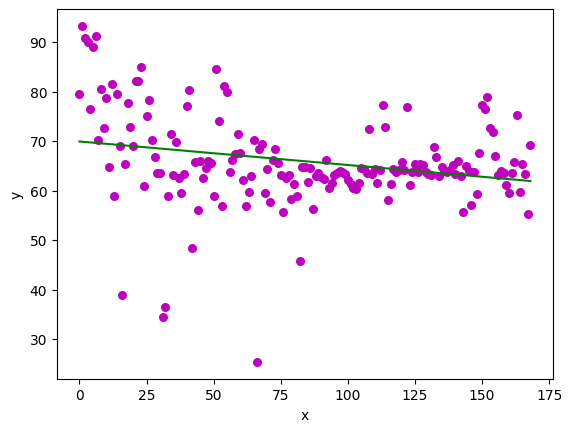

In [83]:
x=df_bin['stt'].tolist()
y=df_bin['Hieu suat'].tolist()
x=np.array(x)
y=np.array(y)
b = estimate_coef(x, y) 
print("Estimated coefficients:\nb_0 = {}\nb_1 = {}".format(b[0], b[1])) 
plot_regression_line(x, y, b) 
y_pred= b[0] + b[1]*x

In [84]:
fig.add_trace(go.Scatter(
    x=df1['date'],
    y=y_pred,
    name="Hiệu suất tuyến tính inverter 4 "))

In [85]:
df2=df.groupby(['month','date','hour'])['Total input power(kW)','Hieu suat'].mean()
df2=df2.reset_index()
df2=df2[df2.groupby(['month','date'])['Hieu suat'].transform(max)==df2['Hieu suat']]
df2=df2.reset_index()
df2=df2[df2['Hieu suat']<100]
print(df2)
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df2['date'],
    y=df2['Total input power(kW)'],
    name="Sản lượng điện trung bình cao nhất theo khung giờ mỗi ngày inverter 4"))
fig.add_trace(go.Scatter(
    x=df2['date'],
    y=df2['Hieu suat'],
    name="Hiệu suất trung bình cao nhất theo khung giờ mỗi ngày inverter 4"))
fig . update_traces (
    showlegend = True 
    )
fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

     index  month        date  hour  Total input power(kW)  Hieu suat
0        3      3  2022-03-03    17               8.793000  90.509420
2        9      3  2022-03-05    10              23.239111  90.847382
3       13      3  2022-03-07    10              28.170833  91.323414
4       18      3  2022-03-08    15              59.717500  95.031458
10      94      3  2022-03-14    15              22.169583  89.081214
..     ...    ...         ...   ...                    ...        ...
164   2165      8  2022-08-21    16              16.329417  79.326961
165   2179      8  2022-08-22    16              31.788917  81.480846
166   2193      8  2022-08-23    16              35.113500  81.759984
167   2207      8  2022-08-24    16              22.757667  76.298127
168   2212      8  2022-08-25     7              20.077250  76.652375

[158 rows x 6 columns]


C:\Users\badao\AppData\Local\Temp\ipykernel_38928\4190541965.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [86]:
i=1
while i<=14:
    c=str(i)
    d='PV'+str(i)+' input voltage(V)'
    df2=df[[d,'time']]
    fig = go.Figure()
    fig.add_trace(go.Scatter(
    x=df2['time'],
    y=df2[d],
    name="Sản lượng điện inverter 4 string "+c+" đã lọc"))
    fig . update_traces (
    showlegend = True 
    )
    fig.update_xaxes(
    rangeslider_visible=True,
    )
    fig.show()
    i=i+1

In [87]:
df3=df[['time']]
i=1
while i<=14:
    c=str(i)
    d='PV'+str(i)+' input voltage(V)'
    e='PV'+str(i)+' input current(A)'
    df3['Input power '+c]=df[d]*df[e]
    i=i+1
i=15
while i<=20:
    c=str(i)
    d='PV'+str(i)+' Input Voltage(V)'
    e='PV'+str(i)+' Input Current(A)'
    df3['Input power '+c]=df[d]*df[e]
    i=i+1

C:\Users\badao\AppData\Local\Temp\ipykernel_38928\972650409.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\badao\AppData\Local\Temp\ipykernel_38928\972650409.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\badao\AppData\Local\Temp\ipykernel_38928\972650409.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

In [88]:
df3.head()

,time,Input power 1,Input power 2,Input power 3,Input power 4,Input power 5,Input power 6,Input power 7,Input power 8,Input power 9,...,Input power 11,Input power 12,Input power 13,Input power 14,Input power 15,Input power 16,Input power 17,Input power 18,Input power 19,Input power 20
datetime,,,,,,,,,,,,,,,,,,,,,
2022-03-03 14:50:00,2022-03-03 14:50:00,1839.922,0.0,0.0,1801.683,1821.820,0.0,0.0,1831.118,1825.092,...,0.0,1801.356,1816.885,0.0,1811.964,0.0,0.0,1851.432,1890.627,0.0
2022-03-03 14:55:00,2022-03-03 14:55:00,1423.308,0.0,0.0,1377.486,1534.533,0.0,0.0,1403.784,1533.840,...,0.0,1380.232,1508.472,0.0,1512.048,0.0,0.0,1422.624,1453.347,0.0
2022-03-03 15:00:00,2022-03-03 15:00:00,1423.308,0.0,0.0,1377.486,1394.393,0.0,0.0,1264.104,1386.234,...,0.0,1368.472,1394.592,0.0,1384.020,0.0,0.0,1283.379,1453.554,0.0
2022-03-03 15:05:00,2022-03-03 15:05:00,1423.308,0.0,0.0,1365.606,1383.448,0.0,0.0,1264.104,1398.174,...,0.0,1380.232,1406.731,0.0,1373.328,0.0,0.0,1293.444,1453.347,0.0
2022-03-03 15:10:00,2022-03-03 15:10:00,1435.344,0.0,0.0,1238.880,1405.935,0.0,0.0,1264.647,1410.114,...,0.0,1379.056,1394.393,0.0,1385.208,0.0,0.0,1294.176,1465.767,0.0


In [89]:
i=1
while i<=20:
    c=str(i)
    d='Input power '+c
    fig = go.Figure()
    fig.add_trace(go.Scatter(
    x=df3['time'],
    y=df3[d],
    name="Sản lượng điện inverter 4 string "+c+" đã lọc"))
    fig . update_traces (
    showlegend = True 
    )
    fig.update_xaxes(
    rangeslider_visible=True,
    )
    fig.show()
    i=i+1

In [90]:
df3['Total input power']= (df3['Input power 1']+df3['Input power 2']+df3['Input power 3']+df3['Input power 4']+df3['Input power 5']+df3['Input power 6']+df3['Input power 7']+df3['Input power 8']+df3['Input power 9']+df3['Input power 10']+df3['Input power 11']+df3['Input power 12']+df3['Input power 13']+df3['Input power 14']+df3['Input power 15']+df3['Input power 16']+df3['Input power 17']+df3['Input power 18']+df3['Input power 19']+df3['Input power 20'])/1000
df3['Auth Total']=df[['Total input power(kW)']]
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df3.index,
    y=df3['Total input power'],
    name="Sản lượng điện tính toán từ string"))
fig.add_trace(go.Scatter(
    x=df3.index,
    y=df3['Auth Total'],
    name="Sản lượng điện đã có"))
fig . update_traces (
    showlegend = True 
    )
fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

C:\Users\badao\AppData\Local\Temp\ipykernel_38928\3784334494.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\badao\AppData\Local\Temp\ipykernel_38928\3784334494.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

